In [1]:
import os
import shutil
import flopy
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

# ! Custom modules
from utils import pht3d_fsp
from utils.tools import calculate_MAS_sums, clear_directory
from utils.pht3d_utils import copy_pht3d_datab, run_pht3d_program

clear_directory()

In [2]:
data_folder = 'case5'
model_name = 'case5_modflow'
model_ws = './models_folder/' + data_folder

Lx = 17
Ly = 1.0

nrow = 1
ncol = 17
nlay = 1

delr = Lx / ncol
delc = Ly / nrow

top = 1.0
botm = 0.0

laytyp = 1

hk = 100.0

nper = 1
perlen = [83,]  
nstp = [830]

model = flopy.modflow.Modflow(modelname=model_name, model_ws=model_ws, exe_name='./bin/mf2005')
dis = flopy.modflow.ModflowDis(model, nlay=nlay, nrow=nrow, ncol=ncol, 
                              delr=delr, delc=delc, top=top, botm=botm,
                              nper=nper, perlen=perlen, nstp=nstp, steady=[True,])

ibound = np.ones((nlay, nrow, ncol), dtype=np.int32)
ibound[0, 0, -1] = -1
strt = np.ones((nlay, nrow, ncol), dtype=np.float32)
bas = flopy.modflow.ModflowBas(model, ibound=ibound, strt=strt)

lpf = flopy.modflow.ModflowLpf(model, hk=hk, laytyp=1, ipakcb=53)

chd_data = {0: [[0, 0, ncol-1, 1.0, 1.0],]}
chd = flopy.modflow.ModflowChd(model, stress_period_data=chd_data)

wel_data = {0: [[0, 0, 0, 9.4584]]}
wel = flopy.modflow.ModflowWel(model, ipakcb=66, stress_period_data=wel_data, unitnumber=78)

lmt = flopy.modflow.ModflowLmt(model, output_file_name='mt3d_link.ftl')

stress_period_data = {}
for kper in range(nper):
    for kstp in range(nstp[kper]):
        stress_period_data[(kper, kstp)] = ["save head", "save drawdown", 
                                            "save budget", "print head", "print budget",]
oc = flopy.modflow.ModflowOc(model, stress_period_data=stress_period_data)#, compact=True)

pcg = flopy.modflow.ModflowPcg(model=model)

model.write_input()
success, mfoutput = model.run_model(silent=True, pause=False, report=True)
if not success:
    raise Exception('MODFLOW did not terminate normally.')

R2 score:  1.0


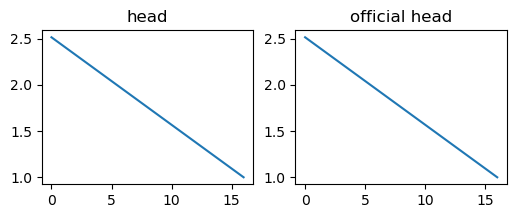

In [3]:
head = flopy.utils.binaryfile.HeadFile(model_ws+'/'+model_name+".hds").get_alldata()
head_official = flopy.utils.binaryfile.HeadFile("./official_examples/ex05_pht3d/mf2k/heads.dat").get_alldata()

plt.figure(figsize=(6,2))
plt.subplot(121)
plt.plot(head[-1, 0, 0])
plt.title("head")
plt.subplot(122)
plt.plot(head_official[-1, 0, 0])
plt.title("official head")

print("R2 score: ", r2_score(np.ravel(head_official), np.ravel(head)))

In [4]:
## Create PHT3D Reactive Transport Model, supported by PHT3D-FSP
## Define "spec", calling PHT3D-FSP (adopt function variables as needed)
spec = pht3d_fsp.create(
    xlsx_path="./", 
    xlsx_name=f"./data/{data_folder}/pht3d_species.xlsx",
    nlay=nlay, 
    nrow=nrow, 
    ncol=ncol,
    ph_os=2,
    ph_temp=25,
    ph_asbin=1,
    ph_eps_aqu=1e-10,
    ph_ph=0.001,
    # ph_print=0,
    ph_cb_offset=0,
    # ph_surf_calc_type="-diffuse_layer",
    write_ph="yes"
)
# Move the pht3d_ph.dat file into the models_folder
source = 'pht3d_ph.dat'
destination = os.path.join(model_ws, 'pht3d_ph.dat')
shutil.move(source, destination)

'./models_folder/case5\\pht3d_ph.dat'

In [5]:
# Define SSM and RCH data (for the SSM package) for each stress period
ssm_data = {}
itype = flopy.mt3d.Mt3dSsm.itype_dict() # ... to check the key words
# print(itype)
# {'CHD': 1, 'BAS6': 1, 'PBC': 1, 'WEL': 2, 'DRN': 3, 'RIV': 4, 'GHB': 5, 'MAS': 15, 'CC': -1}

wel_spec={}

for i in range(1):
    for key in spec.keys():
        wel_spec[key]=spec[key][0,0,0]

    wel_spec['o0'] = 0.0
    wel_spec['c4'] = 0.003651
    wel_spec['ca'] = 0.00213
    wel_spec['cl'] = 0.01466
    wel_spec['na'] = 0.0094
    wel_spec['mg'] = 0.0005

    
    wel_spec['ph'] = 0.0
    wel_spec['pe'] = 0.0

    wel_spec['cax2'] = 0.0
    wel_spec['nax'] = 0.0
    wel_spec['mgx2'] = 0.0

    ssm_per=[0,0,0,0.0,itype['WEL']]
    for key in spec.keys():
        ssm_per.append(wel_spec[key])
    
    ssm_data[i] = ssm_per

wel_spec
ssm_per
ssm_data

{0: [0,
  0,
  0,
  0.0,
  2,
  0.0,
  0.003651,
  0.00213,
  0.01466,
  0.0094,
  0.0005,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0]}

In [6]:
model_name = 'case5_mt3dms'
icbund = np.abs(ibound)

## Initiate model object
mt = flopy.mt3d.Mt3dms(model_name, model_ws=model_ws, exe_name='./bin/mt3dms',
                      ftlfilename='mt3d_link.ftl',modflowmodel=model, namefile_ext='nam_pht3d')

prsity = 0.35
save_times = np.arange(0, 83.1, 0.1)

## Define FloPy packages
exec(f'btn = flopy.mt3d.Mt3dBtn(mt, \
                                nper=nper, perlen=perlen, nstp=nstp,\
                                nlay=nlay, ncol=ncol, nrow=nrow, \
                                laycon=[1], prsity=prsity, icbund=icbund, nprs=1, mxstrn=50000, tsmult=1, timprs=save_times, \
    ncomp={pht3d_fsp.create.ncomp}, mcomp={pht3d_fsp.create.mcomp}, {pht3d_fsp.create.sconc_btn})') # call BTN package in this way to invoke PHT3D-FSP variables

adv = flopy.mt3d.Mt3dAdv(mt, mixelm=-1, percel=0.75, mxpart=5000, nadvfd=0)
dsp = flopy.mt3d.Mt3dDsp(mt, al=1.737, trpt=0.1, trpv=0.1, multiDiff=True, dmcoef=0.0,)
gcg = flopy.mt3d.Mt3dGcg(mt, isolve=1, cclose=1.e-8)
exec(f'ssm = flopy.mt3d.Mt3dSsm(mt, stress_period_data=ssm_data, mxss=1000)')
mt.write_input()

DSP: setting dmcoef for component 2 to zero, kwarg name dmcoef2
DSP: setting dmcoef for component 3 to zero, kwarg name dmcoef3
DSP: setting dmcoef for component 4 to zero, kwarg name dmcoef4
DSP: setting dmcoef for component 5 to zero, kwarg name dmcoef5
DSP: setting dmcoef for component 6 to zero, kwarg name dmcoef6


In [7]:
# Manually add the PHC reaction package to the nam file and push out as pht3d.nam
s='PHC               39  pht3d_ph.dat\n'
namfiletxt=open(model_ws + '/'+ mt.namefile, 'r').read()
pht3d_nam = namfiletxt+s
file = open(model_ws + '/pht3d.nam','w')
file.write(pht3d_nam)
file.close()

In [8]:
copy_pht3d_datab(source_folder=data_folder)

run_pht3d_program(work_dir=data_folder)

The file pht3d_datab.dat has been copied to the model folder.
 PHT3D - [Version 2.10]
 Reactive Multicomponent Transport based on MT3DMS and PHREEQC-2.
 Developed by Henning Prommer / Vincent Post

 Using NAME File: pht3d.nam                                         

 STRESS PERIOD NO.    1
 Calling PHREEQC to equilibrate SSM solutions

 TIME STEP NO.    1
 FROM TIME =   0.0000     TO   0.10000    

 Transport Step:    1   Step Size:   0.000     Total Elapsed Time:   0.0000    
 Transport Step:    2   Step Size:  2.7753E-02 Total Elapsed Time:  2.77531E-02
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   103.7      [K,I,J]    1    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   47.06      [K,I,J]    1    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =   19.52      [K,I,J]    1    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =   8.150      [K,I,J]    1    1    4
 Outer Iter.  1  Inner Iter.  5:  Max. DC =   3.310      [K,I,J]    1    1    5
 Outer Iter.  1  Inner Iter.  6:  Max

(831, 1, 1, 17)


(100.0, 100000.0)

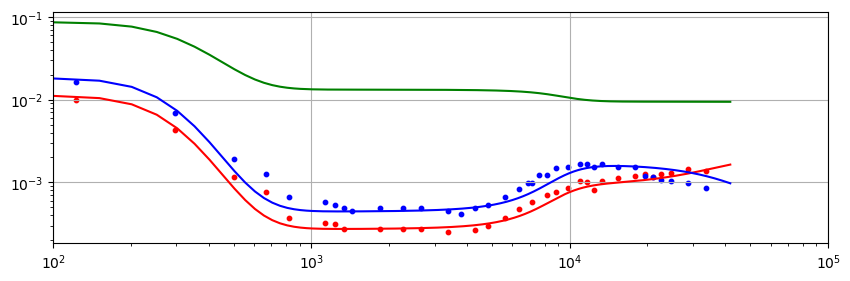

In [9]:
results_ca = flopy.utils.binaryfile.UcnFile(model_ws+'/PHT3D003.UCN').get_alldata()
results_na = flopy.utils.binaryfile.UcnFile(model_ws+'/PHT3D005.UCN').get_alldata()
results_mg = flopy.utils.binaryfile.UcnFile(model_ws+'/PHT3D006.UCN').get_alldata()
results_cl = flopy.utils.binaryfile.UcnFile(model_ws+'/PHT3D004.UCN').get_alldata()

print(results_ca.shape)

# observations
inj_vol_obs = [1, 123.012345, 205.021755, 256.276825, 266.528075, 297.281235, 307.532485, 338.285645, 374.16443, 384.41568, 399.79226, 502.303285, 584.31181, 630.441845, 666.32063, 768.83136, 820.087315, 943.10025, 1127.620095, 1230.130825, 1332.642145, 1435.152875, 1845.19668, 2255.24078, 2665.28281, 3382.8594, 3792.90055, 4305.45715, 4818.0108, 5638.09605, 6355.6747, 6868.22835, 7175.7629, 7585.80405, 8200.87315, 8815.93635, 9841.0466, 10968.6664, 11686.248, 12403.82075, 13326.42145, 15376.639, 17939.4161, 19477.07705, 21014.74095, 22552.4078, 24602.6283, 28703.0516, 33828.594]
Cl_obs = [np.nan, 0.160776, 0.134979, 0.110699, 0.087936, 0.089454, 0.080349, 0.072761, 0.053034, 0.048481, 0.046964, 0.027236, 0.022684, 0.019649, 0.016614, 0.013579, 0.015096, 0.010544, 0.009026, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Ca_obs = [np.nan, 0.01, np.nan, np.nan, np.nan, 0.00425, np.nan, np.nan, np.nan, np.nan, np.nan, 0.00115, np.nan, np.nan, 0.000775, np.nan, 0.000375, np.nan, 0.000325, 0.000312, 0.000275, np.nan, 0.000275, 0.000275, 0.000275, 0.00025, np.nan, 0.000262, 0.0003, 0.000375, 0.000475, np.nan, 0.000575, np.nan, 0.0007, 0.000775, 0.00085, 0.00105, 0.001, 0.0008, 0.001025, 0.001125, 0.0012, 0.00125, 0.001175, 0.001275, 0.0013, 0.00145, 0.001375]
Mg_obs = [np.nan, 0.01646, np.nan, np.nan, np.nan, 0.006995, np.nan, np.nan, np.nan, np.nan, np.nan, 0.001893, np.nan, np.nan, 0.001275, np.nan, 0.000658, np.nan, 0.000576, 0.000534, 0.000493, 0.000452, 0.000493, 0.000493, 0.000493, 0.000452, 0.000411, 0.000493, 0.000534, 0.000658, 0.000823, 0.000987, 0.000987, 0.001234, 0.001234, 0.001481, 0.001522, 0.001646, 0.001646, 0.001522, 0.001646, 0.001522, 0.001522, 0.001193, 0.001152, 0.001069, 0.001028, 0.000987, 0.000864]

times = 831
plt.figure(figsize=(10,3))
cishu = 0
times = np.arange(0, 83.1, 0.1)
plt.plot(times * 21 * 24, results_ca[cishu:,0,0,-1], color='red')
plt.plot(times * 21 * 24, results_na[cishu:,0,0,-1], color='green')
plt.plot(times * 21 * 24, results_mg[cishu:,0,0,-1], color='blue')
plt.scatter(inj_vol_obs, Ca_obs, color='red', s=10)
plt.scatter(inj_vol_obs, Mg_obs, color='blue', s=10)

plt.yscale('log')
plt.xscale('log')
plt.grid()
plt.xlim(1e2, 1e5)

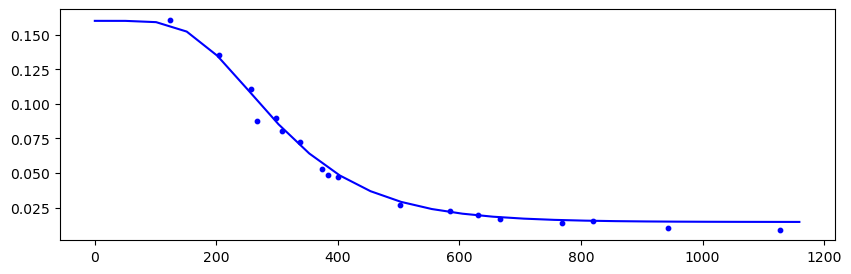

In [10]:
plt.figure(figsize=(10,3))
plt.plot((times * 21 * 24)[:24], results_cl[:,0,0,-1][:24], color='blue')
plt.scatter(inj_vol_obs[:19], Cl_obs[:19], color='blue', s=10)